# A. Setup

## A1. Imports

In [1]:
import pandas as pd
import mat4py
from mat4py import loadmat
import scipy
import numpy as np
from scipy.fft import fft, ifft, fftfreq
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm
import os
# os.system('reset')

In [2]:
from matplotlib.widgets import Slider, Button

## A2. File Config

In [3]:
base_filename = 'Al_0125'
trans = False

In [4]:
NoOfFiles = 8
ExpData = {}
ExpTime = {}
ExpDist = {}

## A3. Read Data

In [5]:
for i in range(0,NoOfFiles):
    FileName = '{}_{}.mat'.format(base_filename, str(i+1))
    StructName = '{}_{}'.format(base_filename, str(i+1))
    ExpData[i] = loadmat(FileName)
    ExpTime[i] = ExpData[i][StructName]['axisValues'][0]
    ExpDist[i] = ExpData[i][StructName]['axisValues'][1]

In [6]:
ExpNoYPosPoints = {}
ExpNoTimePoints = {}
# ExpSignalValues = {}
ExpAmpMatrix = {}
ExpAmpMatrixNorm = {}
ExpNoXPosPoints = NoOfFiles
ExpMaxAmpMatrix = np.empty(shape=(NoOfFiles,len(ExpDist[1])))

## A4. Pre-Process Data

In [7]:
for i in range(0,ExpNoXPosPoints):
    ExpNoYPosPoints[i] = len(ExpDist[1])
    ExpNoTimePoints[i] = len(ExpTime[1])
    ExpAmpMatrix[i] = np.empty(shape=(ExpNoTimePoints[i],ExpNoYPosPoints[i]))
    ExpAmpMatrixNorm[i] = np.empty(shape=(ExpNoTimePoints[i],ExpNoYPosPoints[i]))
    for j in range(0,ExpNoYPosPoints[i]):
        ExpSignalValues = list()
        for k in range(0,ExpNoTimePoints[i]):
            ExpSignalValues.append(ExpData[i][base_filename+'_'+str(i+1)]['data'][k][j])
        ExpAmpMatrix[i][:,j] = ExpSignalValues
        MaxAmpAbs = max(abs(v) for v in ExpSignalValues)
        Normalized = [x / MaxAmpAbs for x in ExpSignalValues]
        ExpAmpMatrixNorm[i][:,j] = Normalized
        ExpMaxAmpMatrix[i,j] = MaxAmpAbs
        ExpSignalValues = []

# B. Plots

## B1. Replay Signal

(CHOOSE POINT INDEX 0-159)

In [8]:
PointToPlot = 2

### SAMPLE OF TIME SIGNAL OF A POINT

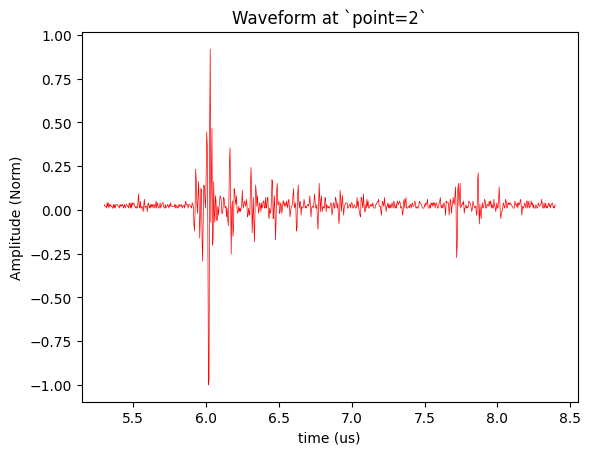

In [9]:
plt.plot(ExpTime[PointToPlot],ExpAmpMatrixNorm[PointToPlot][:,PointToPlot], linewidth=0.5, color='r')
# plt.xlim([min(ExpTime[0]),max(ExpTime[0])])
# plt.ylim([-1.2,1.2])

plt.title("Waveform at `point={}`".format(PointToPlot))
plt.xlabel("time (us)")
plt.ylabel("Amplitude (Norm)")

plt.show()

### Interactive Plot of Raw (Time-Domain) Signal

In [37]:
'''configure data (raw vs. normalized amplitudes)'''
norm = False

if norm: AmpMatrix = ExpAmpMatrixNorm
else:    AmpMatrix = ExpAmpMatrix

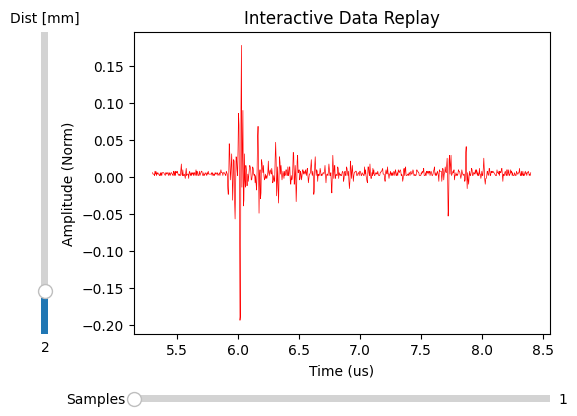

In [38]:
'''set x & y limits (optional)'''
# plt.xlim([min(ExpTime[0]),max(ExpTime[0])])
# plt.ylim([-1.2,1.2])

'''set up the plot'''
# this can be done more simplistically by calling `plt.plot()` as in original code
# but to add interactivity, ax.plot() needs to be called explicitly (as `line` must be saved into a variable)
fig, ax = plt.subplots()
line, = ax.plot(ExpTime[PointToPlot], AmpMatrix[PointToPlot][:,PointToPlot], color='r', lw=0.5)

fig.subplots_adjust(left=0.25, bottom=0.25)

'''labels'''
plt.title("Interactive Data Replay")
plt.xlabel("Time (us)")
plt.ylabel("Amplitude (Norm)")


'''sliders'''
rect1 = fig.add_axes([0.25, 0.1, 0.65, 0.03])
time_slider = Slider(ax=rect1, label='Samples', valmin=1, valmax=len(AmpMatrix[0][0]), valinit=0, valstep=1)
# time_slider = Slider(ax=rect1, label='Time [us]', valmin=1, valmax=len(ExpAmpMatrixNorm[0][0]), valinit=0, valstep=1)

rect2 = fig.add_axes([0.1, 0.25, 0.0225, 0.63])
dist_slider = Slider(ax=rect2, label='Dist [mm]', valmin=1, valmax=len(AmpMatrix), valinit=PointToPlot, valstep=1, orientation='vertical')



'''update function'''
state = [0,0] # time, dist

def update_time(time):
    global state
    state = [time, state[1]]
    line.set_ydata(AmpMatrix[state[1]][:,state[0]])
    fig.canvas.draw_idle()

def update_dist(dist):
    dist -= 1 # account for zero-indexing
    global state
    state = [state[0], dist]
    line.set_ydata(AmpMatrix[state[1]][:,state[0]])
    fig.canvas.draw_idle()

time_slider.on_changed(update_time)
dist_slider.on_changed(update_dist)


plt.show()

## B2. Analysis

### 2D Maximum Amplitude Plot

Note: seems to plot where the maximum amplitude occurs. Y distance (or time) is represented in x-axis, while y-axis is divided into 8 sections each representing distinct x distance (or samples)

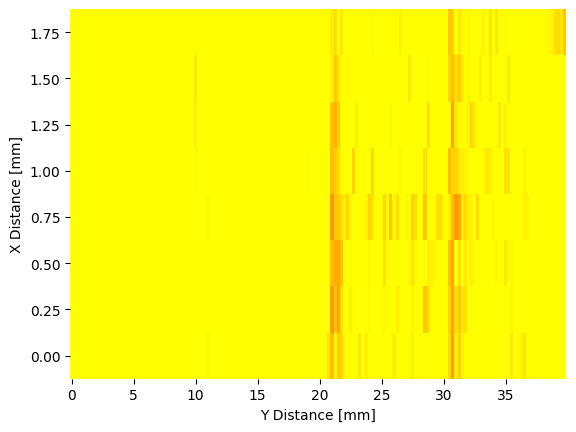

In [12]:
'''data'''
SignalIntDist = ExpMaxAmpMatrix
xAxis = [0,0.25,0.5,0.75,1.00,1.25,1.50,1.75]

'''plot'''
fig, ax = plt.subplots()
ax.pcolormesh(ExpDist[0], xAxis, SignalIntDist, vmin=0.01, vmax=0.1, cmap='autumn', shading='auto')
ax.set_frame_on(False)

'''labels'''
# plt.title(""")
plt.xlabel("Y Distance [mm]")
plt.ylabel("X Distance [mm]")

plt.show()

#### Amplitude Distribution Plot

In [13]:
'''data'''
SignalIntDist = ExpMaxAmpMatrix
xAxis = [0,0.25,0.5,0.75,1.00,1.25,1.50,1.75]

In [14]:
n_ExpAmpMatrix = np.array(ExpAmpMatrix)

In [15]:
# np.unique(n_ExpAmpMatrix)

In [16]:
ExpAmpMatrix[0].max()

0.21484375

In [34]:
[print(ExpAmpMatrix[i].max()) for i in range(len(ExpAmpMatrix))]
[print(ExpAmpMatrix[i].min()) for i in range(len(ExpAmpMatrix))]
pass

0.21484375
0.205078125
0.212890625
0.21875
0.212890625
0.21484375
0.205078125
0.201171875
-0.25
-0.236328125
-0.236328125
-0.25
-0.25
-0.25
-0.25
-0.25


In [36]:
[print(ExpAmpMatrixNorm[i].max()) for i in range(len(ExpAmpMatrix))]
[print(ExpAmpMatrixNorm[i].min()) for i in range(len(ExpAmpMatrix))]
pass

1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
-1.0
-1.0
-1.0
-1.0
-1.0
-1.0
-1.0
-1.0


In [ ]:
# for i in range(len(ExpAmpMatrix)): print(ExpAmpMatrix[i].max())

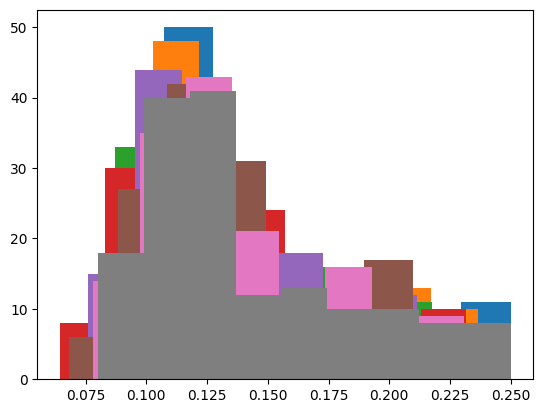

In [42]:
for i in range(len(ExpAmpMatrix)): _ = plt.hist(ExpMaxAmpMatrix[i], bins='auto')  # arguments are passed to np.histogram

plt.show()

In [57]:
ExpAmpMatrix[0].

-0.25

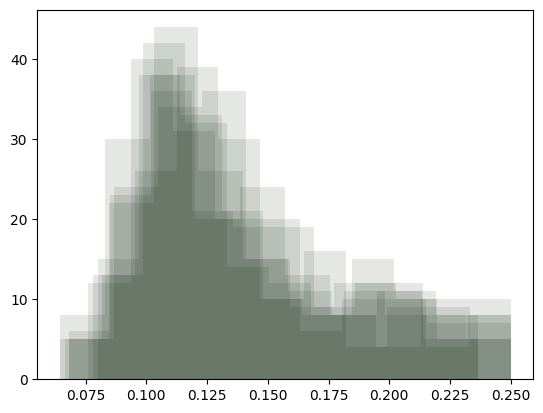

In [56]:
# for i in range(len(ExpAmpMatrix)): plt.hist(ExpMaxAmpMatrix[i], alpha=0.4)  # arguments are passed to np.histogram
for i in range(len(ExpAmpMatrix)): plt.hist(ExpMaxAmpMatrix[i], fc=(0, 0.1, 0, 0.1))  # arguments are passed to np.histogram

plt.show()

# not showing negative values for some reason

In [60]:
np.abs(ExpMaxAmpMatrix[i]).min()

0.080078125

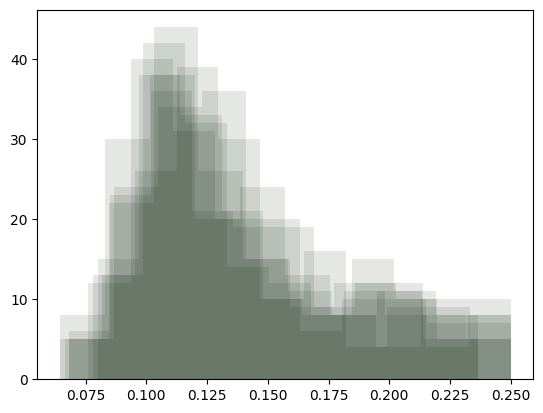

In [58]:
# for i in range(len(ExpAmpMatrix)): plt.hist(ExpMaxAmpMatrix[i], alpha=0.4)  # arguments are passed to np.histogram
for i in range(len(ExpAmpMatrix)): plt.hist(np.abs(ExpMaxAmpMatrix[i]), fc=(0, 0.1, 0, 0.1))  # arguments are passed to np.histogram

plt.show()

# so matplotlib indeed is internally absolute-valuing everything when creating the histogram. hmm weird. 

In [68]:
# ExpMaxAmpMatrix[i].shape
ExpAmpMatrix[i].shape

# Right now I don't have a knowledge of this data structuring at all. wow. 

(775, 160)

In [69]:
ExpMaxAmpMatrix[i].min()
ExpAmpMatrix[i].min()

-0.25

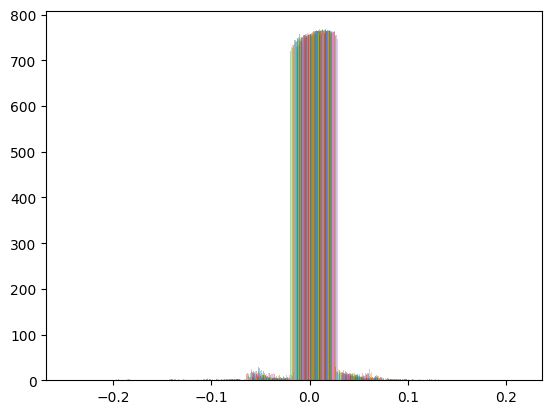

In [70]:
for i in range(len(ExpAmpMatrix)): plt.hist(ExpAmpMatrix[i], alpha=0.4)  # arguments are passed to np.histogram
# for i in range(len(ExpAmpMatrix)): plt.hist(ExpMaxAmpMatrix[i], bins=20, range=(ExpMaxAmpMatrix[i].min(), ExpMaxAmpMatrix[i].max()), fc=(0, 0.1, 0, 0.1))  # arguments are passed to np.histogram
# for i in range(len(ExpAmpMatrix)): plt.hist(ExpMaxAmpMatrix[i], bins=20, range=(-0.25, 0.25), fc=(0, 0.1, 0, 0.1))  # arguments are passed to np.histogram

plt.show()

# so matplotlib indeed is internally absolute-valuing everything when creating the histogram. hmm weird. 

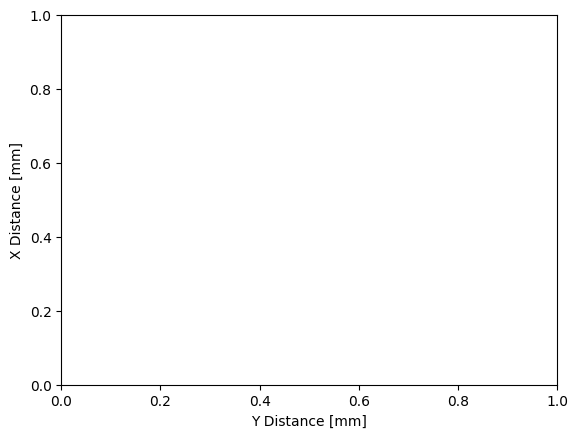

In [19]:
'''plot'''
fig, ax = plt.subplots()
# ax.pcolormesh(ExpDist[0], xAxis, SignalIntDist, vmin=0.01, vmax=0.1, cmap='autumn', shading='auto')

# for i in range(len(ExpAmpMatrix)):
    

'''labels'''
# plt.title(""")
plt.xlabel("Y Distance [mm]")
plt.ylabel("X Distance [mm]")

plt.show()

In [20]:
len(ExpAmpMatrix)


8

#### Interactive Threshold Exploration

Specs
- colormap selection radio buttons (jet, magma, yellow->purple, etc)
- Minimum Threshold: slider & display
- Maximum Threshold: slider & display
- Linear / Exponential / Logarithmic mapping

### FFT (Frequency Domain)

# D. Unused

### Data Inspection

In [21]:
len(ExpTime[PointToPlot])

775

In [22]:
len(ExpAmpMatrixNorm[PointToPlot][:,PointToPlot])

775

In [23]:
ExpAmpMatrix[0].shape

(775, 160)

In [24]:
ExpData

{0: {'Al_0125_1': {'units': 'Volts',
   'axisUnits': ['Usec', 'mm'],
   'axisValues': [[5.3,
     5.303999999999999,
     5.308,
     5.311999999999999,
     5.316,
     5.319999999999999,
     5.324,
     5.327999999999999,
     5.332,
     5.335999999999999,
     5.34,
     5.343999999999999,
     5.348,
     5.351999999999999,
     5.356,
     5.359999999999999,
     5.364,
     5.367999999999999,
     5.372,
     5.3759999999999994,
     5.38,
     5.3839999999999995,
     5.388,
     5.3919999999999995,
     5.396,
     5.3999999999999995,
     5.404,
     5.4079999999999995,
     5.412,
     5.4159999999999995,
     5.42,
     5.4239999999999995,
     5.428,
     5.4319999999999995,
     5.436,
     5.4399999999999995,
     5.444,
     5.4479999999999995,
     5.452,
     5.4559999999999995,
     5.46,
     5.4639999999999995,
     5.468,
     5.4719999999999995,
     5.476,
     5.4799999999999995,
     5.484,
     5.4879999999999995,
     5.492,
     5.4959999999999996,
     5.

In [25]:
len(ExpAmpMatrixNorm)

8

In [26]:
len(ExpAmpMatrixNorm[0][:])

775

In [27]:
len(ExpAmpMatrixNorm[0][0])

160

In [28]:
ExpAmpMatrixNorm[0][:].shape

(775, 160)

In [29]:
ExpAmpMatrixNorm[0][:,0].shape

(775,)

In [30]:
ExpAmpMatrixNorm[0][:,1].shape

(775,)

In [31]:
ExpAmpMatrixNorm[0][:,3].shape

(775,)